In [4]:
import xarray as xr
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

In [5]:
# read nc file
ds = xr.open_dataset(r"D:\disaster_tweet\typhoon_time\ncep_global_68e9_b0dc_8fd1.nc", engine="netcdf4")
ds

<xarray.Dataset>
Dimensions:    (time: 1153, latitude: 121, longitude: 65)
Coordinates:
  * time       (time) datetime64[ns] 2022-01-01T12:00:00 ... 2022-05-25T12:00:00
  * latitude   (latitude) float64 0.0 0.5 1.0 1.5 2.0 ... 58.5 59.0 59.5 60.0
  * longitude  (longitude) float64 118.0 118.5 119.0 119.5 ... 149.0 149.5 150.0
Data variables:
    tmpsfc     (time, latitude, longitude) float32 ...
    tmp2m      (time, latitude, longitude) float32 ...
    ugrd10m    (time, latitude, longitude) float32 ...
    vgrd10m    (time, latitude, longitude) float32 ...
    pratesfc   (time, latitude, longitude) float32 ...
    rh2m       (time, latitude, longitude) float32 ...
    prmslmsl   (time, latitude, longitude) float32 ...
Attributes: (12/63)
    _CoordSysBuilder:           ucar.nc2.dataset.conv.CF1Convention
    acknowledgement:            The Pacific Islands Ocean Observing System (P...
    cdm_data_type:              Grid
    Conventions:                CF-1.6, ACDD-1.3
    creator_email:              ncep.list.pmb-dataflow@lstsrv.ncep.noaa.gov
    creator_institution:        NOAA National Centers for Environmental Predi...
    ...                         ...
    testOutOfDate:              now+136hours
    time_coverage_end:          2022-05-25T12:00:00Z
    time_coverage_resolution:   PT3H
    time_coverage_start:        2022-01-01T12:00:00Z
    title:                      NOAA/NCEP Global Forecast System (GFS) Atmosp...
    Westernmost_Easting:        118.0

In [6]:
ds_windspeed = np.sqrt(ds.ugrd10m**2+ds.vgrd10m**2)
ds_windspeed

<xarray.DataArray (time: 1153, latitude: 121, longitude: 65)>
array([[[ 7.320606  ,  6.0038567 ,  7.8588967 , ...,  4.2870936 ,
          4.7293997 ,  4.5303926 ],
        [ 7.2961807 ,  6.0136623 ,  7.291769  , ...,  5.2500052 ,
          4.0581355 ,  3.5469422 ],
        [ 1.2167668 ,  1.2601736 ,  5.2660365 , ...,  5.2170796 ,
          5.3074512 ,  4.259343  ],
        ...,
        [ 3.1959684 ,  2.0950356 ,  1.5873611 , ...,  6.4366674 ,
         10.616114  , 10.791305  ],
        [ 2.9239008 ,  2.2302475 ,  1.8197857 , ...,  4.57071   ,
          7.533985  ,  6.242316  ],
        [ 1.5366793 ,  0.42822018,  1.0083675 , ...,  6.0751677 ,
          4.5789227 ,  5.5835404 ]],

       [[ 7.8288846 ,  6.3095384 ,  6.674029  , ...,  4.5722055 ,
          3.6464636 ,  3.1491077 ],
        [ 7.140709  ,  4.7779975 ,  7.4747086 , ...,  4.5970182 ,
          4.840778  ,  3.8920789 ],
        [ 1.1620522 ,  1.1569252 ,  6.0390244 , ...,  4.9013486 ,
          5.2860293 ,  4.3339763 ],
...
        [ 6.15825   ,  5.2235365 ,  4.9960294 , ...,  3.5902076 ,
          3.6823237 ,  3.9650152 ],
        [ 5.66963   ,  5.1726623 ,  5.2883453 , ...,  2.2297132 ,
          2.3071775 ,  2.942202  ],
        [ 7.414361  ,  5.1350155 ,  5.6983976 , ...,  2.7007592 ,
          2.305201  ,  2.5697145 ]],

       [[ 5.0734167 ,  3.412209  ,  2.6432202 , ...,  5.0732026 ,
          5.4898896 ,  5.6238656 ],
        [ 4.5564656 ,  4.63516   ,  3.81577   , ...,  5.0075    ,
          5.4664745 ,  5.427032  ],
        [ 0.643359  ,  1.0818865 ,  3.4512231 , ...,  4.9142847 ,
          4.3962574 ,  5.0130367 ],
        ...,
        [ 3.6624563 ,  2.879381  ,  2.1483533 , ...,  0.9893345 ,
          1.5335829 ,  2.237975  ],
        [ 2.8959994 ,  2.669747  ,  3.4598432 , ...,  1.7238908 ,
          2.0499058 ,  2.423816  ],
        [ 5.3823624 ,  3.055668  ,  2.7419796 , ...,  2.256377  ,
          1.3392093 ,  1.1923637 ]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 2022-01-01T12:00:00 ... 2022-05-25T12:00:00
  * latitude   (latitude) float64 0.0 0.5 1.0 1.5 2.0 ... 58.5 59.0 59.5 60.0
  * longitude  (longitude) float64 118.0 118.5 119.0 119.5 ... 149.0 149.5 150.0

In [43]:
#tw_ds_windspeed = ds_windspeed.sel(latitude=slice(0,40), longitude=slice(118,150),time=slice("2022-05-01", "2022-05-02"))
tw_ds_windspeed = ds_windspeed.sel(latitude=slice(0,40), longitude=slice(118,150))
tw_ds_windspeed

<xarray.DataArray (time: 1153, latitude: 81, longitude: 65)>
array([[[ 7.320606  ,  6.0038567 ,  7.8588967 , ...,  4.2870936 ,
          4.7293997 ,  4.5303926 ],
        [ 7.2961807 ,  6.0136623 ,  7.291769  , ...,  5.2500052 ,
          4.0581355 ,  3.5469422 ],
        [ 1.2167668 ,  1.2601736 ,  5.2660365 , ...,  5.2170796 ,
          5.3074512 ,  4.259343  ],
        ...,
        [ 9.768434  , 11.848625  , 11.664808  , ..., 17.012156  ,
         16.863943  , 15.503267  ],
        [ 7.831308  ,  7.4448156 ,  7.416559  , ..., 16.40637   ,
         15.65823   , 15.151265  ],
        [ 7.122717  ,  5.328184  ,  2.6833193 , ..., 16.118431  ,
         15.657514  , 14.214121  ]],

       [[ 7.8288846 ,  6.3095384 ,  6.674029  , ...,  4.5722055 ,
          3.6464636 ,  3.1491077 ],
        [ 7.140709  ,  4.7779975 ,  7.4747086 , ...,  4.5970182 ,
          4.840778  ,  3.8920789 ],
        [ 1.1620522 ,  1.1569252 ,  6.0390244 , ...,  4.9013486 ,
          5.2860293 ,  4.3339763 ],
...
        [ 5.833952  ,  4.766244  ,  5.950721  , ...,  4.967052  ,
          4.2552733 ,  4.209963  ],
        [ 7.233096  ,  6.7920194 ,  5.246519  , ...,  4.5818515 ,
          4.344752  ,  3.377105  ],
        [ 4.931256  ,  5.0198293 ,  6.1000223 , ...,  3.5657427 ,
          2.7654805 ,  1.9465244 ]],

       [[ 5.0734167 ,  3.412209  ,  2.6432202 , ...,  5.0732026 ,
          5.4898896 ,  5.6238656 ],
        [ 4.5564656 ,  4.63516   ,  3.81577   , ...,  5.0075    ,
          5.4664745 ,  5.427032  ],
        [ 0.643359  ,  1.0818865 ,  3.4512231 , ...,  4.9142847 ,
          4.3962574 ,  5.0130367 ],
        ...,
        [ 5.349556  ,  4.4018598 ,  5.127903  , ...,  5.274582  ,
          5.142283  ,  4.8606853 ],
        [ 3.1188395 ,  3.2438378 ,  2.4950807 , ...,  5.146234  ,
          4.818369  ,  4.5986915 ],
        [ 1.5326854 ,  2.3046849 ,  2.0255654 , ...,  4.714012  ,
          4.113329  ,  3.4318442 ]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 2022-01-01T12:00:00 ... 2022-05-25T12:00:00
  * latitude   (latitude) float64 0.0 0.5 1.0 1.5 2.0 ... 38.5 39.0 39.5 40.0
  * longitude  (longitude) float64 118.0 118.5 119.0 119.5 ... 149.0 149.5 150.0

Save  2022_01_01_12_00_00 .jpg
Save  2022_01_01_15_00_00 .jpg
Save  2022_01_01_18_00_00 .jpg
Save  2022_01_01_21_00_00 .jpg
Save  2022_01_02_00_00_00 .jpg
Save  2022_01_02_03_00_00 .jpg
Save  2022_01_02_06_00_00 .jpg
Save  2022_01_02_09_00_00 .jpg
Save  2022_01_02_12_00_00 .jpg
Save  2022_01_02_15_00_00 .jpg
Save  2022_01_02_18_00_00 .jpg
Save  2022_01_02_21_00_00 .jpg
Save  2022_01_03_00_00_00 .jpg
Save  2022_01_03_03_00_00 .jpg
Save  2022_01_03_06_00_00 .jpg
Save  2022_01_03_09_00_00 .jpg
Save  2022_01_03_12_00_00 .jpg
Save  2022_01_03_15_00_00 .jpg
Save  2022_01_03_18_00_00 .jpg
Save  2022_01_03_21_00_00 .jpg
Save  2022_01_04_00_00_00 .jpg
Save  2022_01_04_03_00_00 .jpg


C:\Users\user\AppData\Local\Temp\ipykernel_13656\1192024207.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(400/my_dpi, 300/my_dpi), dpi=my_dpi)


Save  2022_01_04_06_00_00 .jpg
Save  2022_01_04_09_00_00 .jpg
Save  2022_01_04_12_00_00 .jpg
Save  2022_01_04_15_00_00 .jpg
Save  2022_01_04_18_00_00 .jpg
Save  2022_01_04_21_00_00 .jpg
Save  2022_01_05_00_00_00 .jpg
Save  2022_01_05_03_00_00 .jpg
Save  2022_01_05_06_00_00 .jpg
Save  2022_01_05_09_00_00 .jpg
Save  2022_01_05_12_00_00 .jpg
Save  2022_01_05_15_00_00 .jpg
Save  2022_01_05_18_00_00 .jpg
Save  2022_01_05_21_00_00 .jpg
Save  2022_01_06_00_00_00 .jpg
Save  2022_01_06_03_00_00 .jpg
Save  2022_01_06_06_00_00 .jpg
Save  2022_01_06_09_00_00 .jpg
Save  2022_01_06_12_00_00 .jpg
Save  2022_01_06_15_00_00 .jpg
Save  2022_01_06_18_00_00 .jpg
Save  2022_01_06_21_00_00 .jpg
Save  2022_01_07_00_00_00 .jpg
Save  2022_01_07_03_00_00 .jpg
Save  2022_01_07_06_00_00 .jpg
Save  2022_01_07_09_00_00 .jpg
Save  2022_01_07_12_00_00 .jpg
Save  2022_01_07_15_00_00 .jpg
Save  2022_01_07_18_00_00 .jpg
Save  2022_01_07_21_00_00 .jpg
Save  2022_01_08_00_00_00 .jpg
Save  2022_01_08_03_00_00 .jpg
Save  20

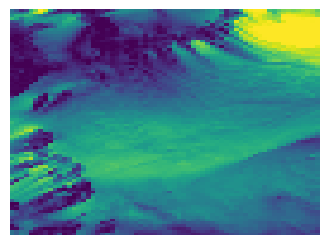

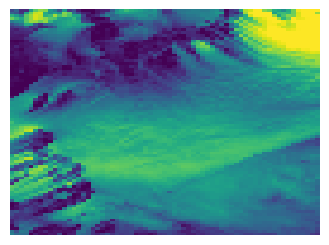

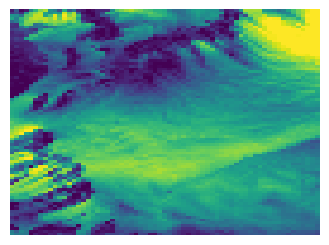

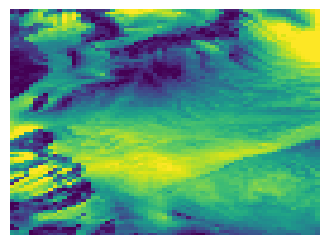

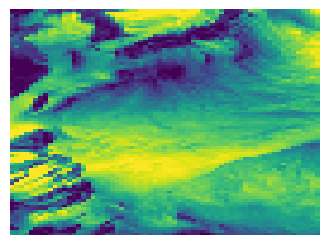

...

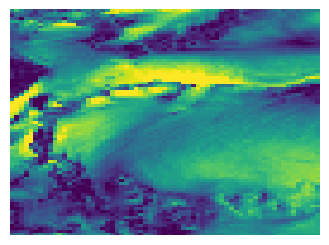

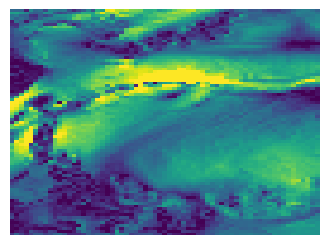

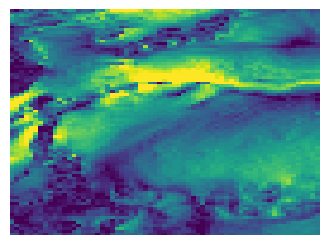

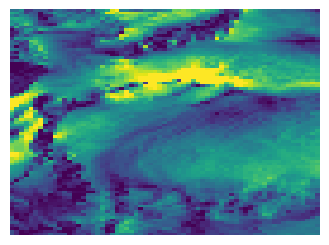

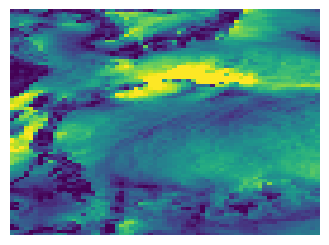

In [44]:
import os
time_list = tw_ds_windspeed.time
my_dpi = 96

output_path = r'D:\disaster_tweet\typhoon_time\wind'

for t in time_list.values:
    new_t = str(pd.to_datetime(t)).replace(" ","_").replace(":","_").replace("-","_")
    
    plt.figure(figsize=(400/my_dpi, 300/my_dpi), dpi=my_dpi)
    tw_ds_windspeed.sel(time = t).plot(robust=True,add_colorbar=False)
    plt.title("")
    plt.xlabel("")
    plt.ylabel("")
    plt.axis('off')
    output_name = new_t
    final_name = os.path.join(output_path , (output_name + '.jpg'))
    plt.savefig(final_name,dpi=my_dpi,bbox_inches = 'tight') #bbox_inches = 'tight'
    print("Save ",output_name,".jpg")
    #plt.show()

In [45]:
import gc
gc.collect()

3333043

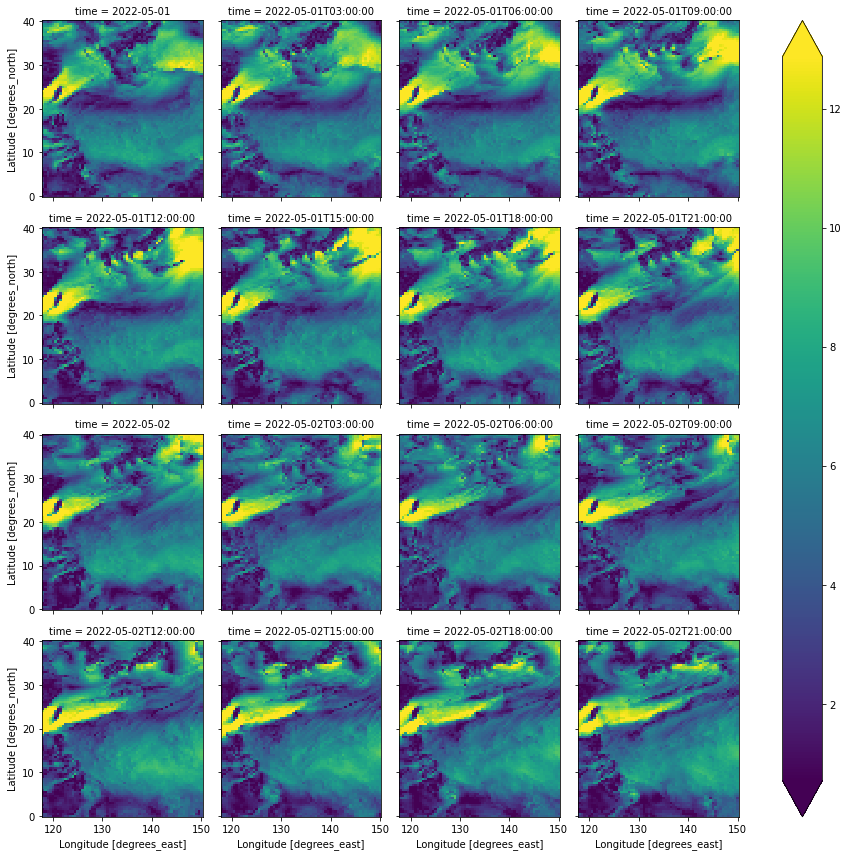

In [46]:
tw_ds_windspeed = ds_windspeed.sel(latitude=slice(0,40), longitude=slice(118,150),time=slice("2022-05-01", "2022-05-02"))
tw_ds_windspeed.plot(col="time", col_wrap=4, robust=True)

In [53]:
# Make dataset

import os
import cv2
from os.path import isfile, join


img_dir = r'D:\disaster_tweet\typhoon_time\wind'
suffix = '.jpg'
fname = os.listdir(img_dir)


images = []

for name in fname:
    
    fullpath = join(img_dir,name)
    
    if isfile(fullpath) and fullpath.endswith(suffix):
        img = cv2.imread(fullpath,0)
        images.append(img)
        print(name,' done')
    

    
images = np.array(images)
images = images.reshape((images.shape[0], images[0].shape[0], images[0].shape[1], 1))
print(images.shape)

2022_01_01_12_00_00.jpg  done
2022_01_01_15_00_00.jpg  done
2022_01_01_18_00_00.jpg  done
2022_01_01_21_00_00.jpg  done
2022_01_02_00_00_00.jpg  done
2022_01_02_03_00_00.jpg  done
2022_01_02_06_00_00.jpg  done
2022_01_02_09_00_00.jpg  done
2022_01_02_12_00_00.jpg  done
2022_01_02_15_00_00.jpg  done
2022_01_02_18_00_00.jpg  done
2022_01_02_21_00_00.jpg  done
2022_01_03_00_00_00.jpg  done
2022_01_03_03_00_00.jpg  done
2022_01_03_06_00_00.jpg  done
2022_01_03_09_00_00.jpg  done
2022_01_03_12_00_00.jpg  done
2022_01_03_15_00_00.jpg  done
2022_01_03_18_00_00.jpg  done
2022_01_03_21_00_00.jpg  done
2022_01_04_00_00_00.jpg  done
2022_01_04_03_00_00.jpg  done
2022_01_04_06_00_00.jpg  done
2022_01_04_09_00_00.jpg  done
2022_01_04_12_00_00.jpg  done
2022_01_04_15_00_00.jpg  done
2022_01_04_18_00_00.jpg  done
2022_01_04_21_00_00.jpg  done
2022_01_05_00_00_00.jpg  done
2022_01_05_03_00_00.jpg  done
2022_01_05_06_00_00.jpg  done
2022_01_05_09_00_00.jpg  done
2022_01_05_12_00_00.jpg  done
2022_01_05

In [54]:
# Save to npy
np.save(r'D:\disaster_tweet\typhoon_time\images.npy', images)
print("npy saved...")

npy saved...
